In [1]:
%matplotlib notebook

import numpy as np

import matplotlib
import matplotlib.pyplot as plt

import matplotlib.animation as animation


In [2]:
def S_nb(grid):
    grid_sum = np.zeros((np.shape(grid)))
    
    #values of the neighbors at the center of the grid
    grid_sum[1:-1,1:-1] = (grid[0:-2,0:-2]+grid[0:-2,1:-1]+grid[0:-2,2:]+
                           grid[1:-1,0:-2]+grid[1:-1,2:]+
                           grid[2:,0:-2]+grid[2:,1:-1]+grid[2:,2:])

    #values of the neighbors at the center of the borders of the grid (periodic boundary conditions)
    grid_sum[1:-1,0] = (grid[0:-2,-1]+grid[0:-2,0]+grid[0:-2,1]+
                           grid[1:-1,-1]+grid[1:-1,1]+
                           grid[2:,-1]+grid[2:,0]+grid[2:,1])
    grid_sum[1:-1,-1] = (grid[0:-2,-2]+grid[0:-2,-1]+grid[0:-2,0]+
                           grid[1:-1,-2]+grid[1:-1,0]+
                           grid[2:,-2]+grid[2:,-1]+grid[2:,0])
    grid_sum[0,1:-1] = (grid[-1,0:-2]+grid[-1,1:-1]+grid[-1,2:]+
                           grid[0,0:-2]+grid[0,2:]+
                           grid[1,0:-2]+grid[1,1:-1]+grid[1,2:])
    grid_sum[-1,1:-1] = (grid[-2,0:-2]+grid[-2,1:-1]+grid[-2,2:]+
                           grid[-1,0:-2]+grid[-1,2:]+
                           grid[0,0:-2]+grid[0,1:-1]+grid[0,2:])

    #values at the corners (periodic boundary conditions)
    grid_sum[0,0] = (grid[-1,-1]+grid[-1,0]+grid[-1,1]+
                           grid[0,-1]+grid[0,1]+
                           grid[1,-1]+grid[1,0]+grid[1,1])
    grid_sum[0,-1] = (grid[-1,-2]+grid[-1,-1]+grid[-1,0]+
                           grid[0,-2]+grid[0,0]+
                           grid[1,-2]+grid[1,-1]+grid[1,0])
    grid_sum[-1,-1] = (grid[-2,-2]+grid[-2,-1]+grid[-2,0]+
                           grid[-1,-2]+grid[-1,0]+
                           grid[0,-2]+grid[0,-1]+grid[0,0])
    grid_sum[-1,0] = (grid[-2,-1]+grid[-2,0]+grid[-2,1]+
                           grid[-1,-1]+grid[-1,1]+
                           grid[0,-1]+grid[0,0]+grid[0,1])

    return grid_sum

In [3]:
def update_grid(grid):
    grid0 = grid
    S = S_nb(grid)
    S0 = np.where(S==3,1,0)
    S1 = np.where((S==2)|(S==3),1,0)

    grid1=(1-grid0)*(S0)+grid0*S1

    return grid1


In [4]:
N = 200
grid = np.zeros((N,2*N))
grid[int(N/2),N] = 1
grid[int(N/2)+1,N+1] = 1
grid[int(N/2)+1,N+2] = 1
grid[int(N/2),N+2] = 1
grid[int(N/2)-1,N+2] = 1

Nt = 20
grid_ani = np.zeros((N,2*N,Nt))
grid_ani[:,:,0] = grid[:,:]


for i in range(Nt-1):
    grid_ani[:,:,i+1] = update_grid(grid_ani[:,:,i])

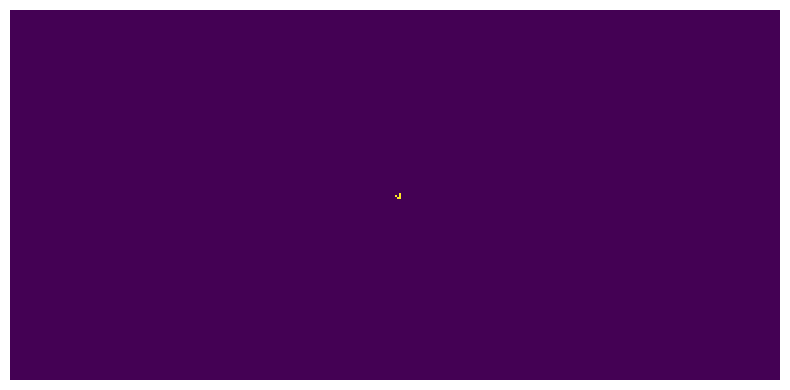

In [6]:
%matplotlib inline
fig = plt.figure( figsize=(8,4) )

fps = 60

im = plt.imshow(grid_ani[:,:,0], interpolation='none', aspect='auto', vmin=0, vmax=1)

def animate_func(i):

    im.set_array(grid_ani[:,:,i])
    return [im]

anim = animation.FuncAnimation(
                               fig, 
                               animate_func, 
                               frames = Nt,
                               interval = 1000/fps, # in ms
                               )

plt.axis('off')
plt.tight_layout()


anim.save('glider_test.mp4', fps=fps, extra_args=['-vcodec', 'libx264'])

from IPython.display import HTML
HTML(anim.to_jshtml())

In [7]:
N = 200
grid = np.random.randint(2, size=(N,2*N))

Nt = 2000
grid_ani = np.zeros((N,2*N,Nt))
grid_ani[:,:,0] = grid[:,:]


for i in range(Nt-1):
    grid_ani[:,:,i+1] = update_grid(grid_ani[:,:,i])

Animation size has reached 20979104 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


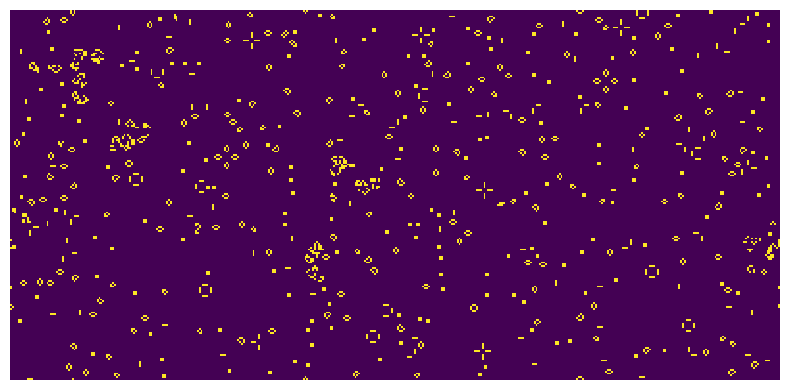

In [8]:
%matplotlib inline
fig = plt.figure( figsize=(8,4) )

fps = 60

im = plt.imshow(grid_ani[:,:,0], interpolation='none', aspect='auto', vmin=0, vmax=1)

def animate_func(i):

    im.set_array(grid_ani[:,:,i])
    return [im]

anim = animation.FuncAnimation(
                               fig, 
                               animate_func, 
                               frames = Nt,
                               interval = 1000/fps, # in ms
                               )

plt.axis('off')
plt.tight_layout()


anim.save('random_game_of_life.mp4', fps=fps, extra_args=['-vcodec', 'libx264'])

from IPython.display import HTML
HTML(anim.to_jshtml())